<a href="https://colab.research.google.com/github/notenoughsun/vrlab_inventory/blob/master/video_conv_yolo5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup

Clone repo, install dependencies, `%cd` into `./yolov5` folder and check GPU.

In [8]:
# %mkdir /content2/
%cd /content/

!git clone https://github.com/ultralytics/yolov5  # clone repo
!pip install -qr yolov5/requirements.txt  # install dependencies (ignore errors)
%cd /content/yolov5
import torch
from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets
clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.6.0+cu101 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15079MB, multi_processor_count=40)


# 1. Inference

Run inference with a pretrained checkpoint on contents of `/inference/images` folder. Models are auto-downloaded from [Google Drive](https://drive.google.com/open?id=1Drs_Aiu7xx6S-ix95f9kNsA6ueKRpN2J).

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=416, iou_thres=0.5, output='inference/output', save_txt=False, source='inference/images/', update=False, view_img=False, weights=['yolov5s.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15079MB)

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   279    0   279    0     0   2447      0 --:--:-- --:--:-- --:--:--  2447
100   408    0   408    0     0    841      0 --:--:-- --:--:-- --:--:--     0
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 14.4M    0 14.4M    0     0   9.8M      0 --:--:--  0:00:01 --:--:--  158M
Fusing layers... Model Summary: 140 layers, 7.45958e+06 parameters, 6.61683e+06 gradients
image 1/2 /content/yolov5/inference/

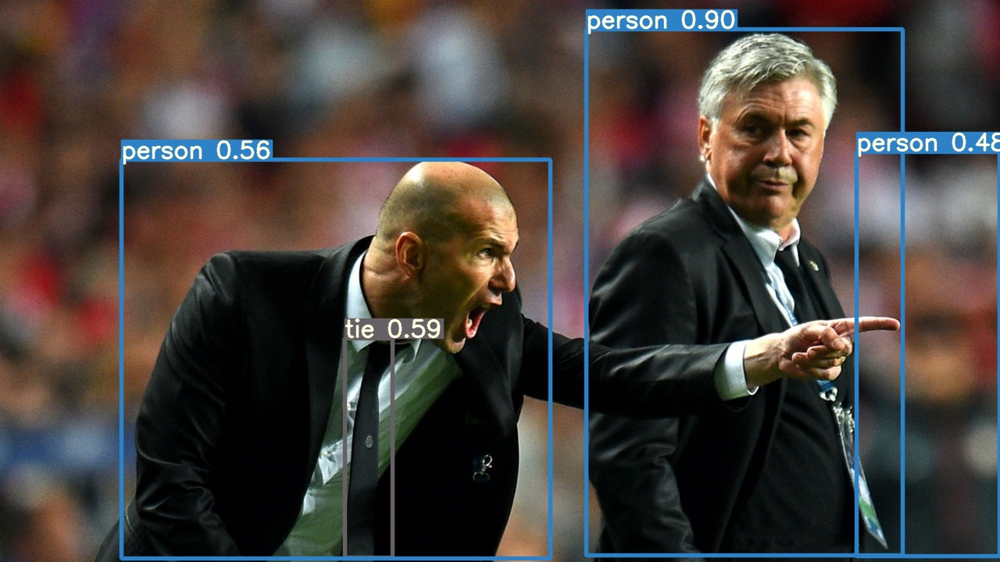

In [9]:
!python detect.py --weights yolov5s.pt --img 416 --conf 0.4 --source inference/images/
Image(filename='inference/output/zidane.jpg', width=600)

# 2. Test
Test a model on COCO val or test-dev dataset to determine trained accuracy. Models are auto-downloaded from [Google Drive](https://drive.google.com/open?id=1Drs_Aiu7xx6S-ix95f9kNsA6ueKRpN2J). To show results by class use the `--verbose` flag. Note that `pycocotools` metrics may be 1-2% better than the equivalent repo metrics, as is visible below, due to slight differences in mAP computation.

In [ ]:
# # Run YOLOv5x on COCO val2017
%cd /content/yolov5/
# !python test.py --weights yolov5x.pt --data coco.yaml --img 672
!python test.py --weights yolov5x.pt --data custom.yaml --img 416

# 3. Train

Download https://www.kaggle.com/ultralytics/coco128, a small 128-image tutorial dataset, start tensorboard and train YOLOv5s from a pretrained checkpoint for 3 epochs (actual training is much longer, around **300-1000 epochs**, depending on your dataset).

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')
#copy results to drive
# %cp runs/exp15_yolov5s_v3/weights/best_yolov5s_v3.pt /content/gdrive/My\ Drive
# runs/exp15_yolov5s_v3/weights/best_yolov5s_v3.pt 


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [11]:
%cp /content/gdrive/My\ Drive/best_yolov5s_v3.pt /content/yolov5/weights/yolov5s_v3.pt
%cp /content/gdrive/My\ Drive/training/weights/yolov5l/last.pt /content/yolov5/weights/yolov5l.pt 
# %ls /content/yolov5/weights/

Train a YOLOv5s model on coco128 by specifying model config file `--cfg models/yolo5s.yaml`, and dataset config file `--data data/coco128.yaml`. Start training from pretrained `--weights yolov5s.pt`, or from randomly initialized `--weights ''`. Pretrained weights are auto-downloaded from [Google Drive](https://drive.google.com/open?id=1Drs_Aiu7xx6S-ix95f9kNsA6ueKRpN2J).

**All training results are saved to `runs/exp0`** for the first experiment, then `runs/exp1`, `runs/exp2` etc. for subsequent experiments.


In [ ]:
%cd /content
# data 5
# !curl -L "https://app.roboflow.ai/ds/irhD5VB5zS?key=i41LgjpvjS" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

# data 6
!curl -L "https://app.roboflow.ai/ds/rLMcZEzY7I?key=CxHlyn2p7P" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

# !curl -L "https://app.roboflow.ai/ds/lst1Jd2dYW?key=n2vyrf0dKy" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip
# !curl -L "https://app.roboflow.ai/ds/MTGMojPX8d?key=bk9rAoL305" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip
# %cp /content/data.yaml /content/yolov5/data/data2.yaml
%cp /content/data.yaml /content/yolov5/data/data3.yaml
%cat /content/data.yaml

# %ls /content2/yolov5/runs/exp14_yolov5s_v3/weights/
# %cp /content2/yolov5/runs/exp14_yolov5s_v3/weights/best_yolov5s_v3.pt /content2/yolov5/runs/yolov5s_res.pt
# %ls /content/yolov5/runs/exp1_yolov5l/weights/
# %ls /content/yolov5/runs/

In [ ]:
from os import listdir
from os.path import isfile, join
(_, _, filenames) = walk(mypath).next()
# onlyfiles = [f for f in listdir(mypath) if isfile(join(mypath, f))]
print(filenames)

In [75]:
# Start tensorboard (optional)
%load_ext tensorboard
%tensorboard --logdir /content/yolov5/runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [72]:
 %reload_ext tensorboard

In [ ]:
%cd /content/yolov5/
# !python train.py --img 416 --batch 16 --epochs 400 --data data2.yaml --cfg yolov5s.yaml --weights 'weights/last_yolov5s.pt' --name yolov5s --cache
!python train.py --img 640 --batch 64 --epochs 400 --data data2.yaml --cfg yolov5s.yaml --weights '/content/yolov5/weights/yolov5s_v3.pt' --name yolov5s --cache

In [70]:
!sed -i 's/lr0: 0.006/lr0: 0.001/g' data/hyp.finetune.yaml
# %ls data/

In [71]:
%cd /content/yolov5/
# !python train.py --img 416 --batch 16 --epochs 400 --data data2.yaml --cfg yolov5s.yaml --weights 'weights/last_yolov5s.pt' --name yolov5s --cache
!python train.py --img 416 --batch 16 --epochs 600 --data data3.yaml --cfg yolov5l.yaml --weights 'weights/best_yolov5l.pt' --name yolov5l --cache

/content/yolov5
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15079MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/yolov5l.yaml', data='./data/data3.yaml', device='', epochs=600, evolve=False, global_rank=-1, hyp='data/hyp.finetune.yaml', img_size=[416, 416], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov5l', noautoanchor=False, nosave=False, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=16, weights='weights/best_yolov5l.pt', world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
2020-08-09 23:19:30.244446: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Hyperparameters {'lr0': 0.001, 'momentum': 0.937, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma': 0.0, 'hsv_h': 0.015

In [76]:
# %ls runs/exp7_yolov5l/weights/
%cd /content/yolov5/
# %cp runs/exp0_yolov5s/weights/last_yolov5s.pt weights/last_yolov5s.pt
# %cp runs/exp8_yolov5l/weights/best_yolov5s.pt weights/best_yolov5l.pt
%cp runs/exp8_yolov5l/weights/best_yolov5l.pt weights/best_yolov5l.pt
# %cp runs/exp8_yolov5l/weights/last_yolov5l.pt /content/gdrive/My\ Drive/training/weights/yolov5l_last.pt
# %cp runs/exp8_yolov5l/weights/best_yolov5l.pt /content/gdrive/My\ Drive/training/weights/yolov5l_best.pt

/content/yolov5


# 4. Visualize

View `runs/exp0/train*.jpg` images to see training images, labels and augmentation effects. A **Mosaic Dataloader** is used for training (shown below), a new concept developed by Ultralytics and first featured in [YOLOv4](https://arxiv.org/abs/2004.10934).

In [28]:
%ls runs/

from IPython.display import Image, clear_output  # to display images

exp0_yolov5s/  exp1_yolov5s/  exp2_yolov5s/  exp3_yolov5s/


View `test_batch0_gt.jpg` to see test batch 0 *ground truth* labels.

In [ ]:
Image(filename='runs/exp5_yolov5s/test_batch0_gt.jpg', width=900)  # view test image labels
# /content/yolov5/weights/last_yolov5s2.pt

View `test_batch0_pred.jpg` to see test batch 0 *predictions*.

In [ ]:
# Image(filename='runs/exp5_yolov5s/test_batch0_pred.jpg', width=900)  # view test image predictions


Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=416, iou_thres=0.5, output='inference/output', save_txt=False, source='/content/test.jpg', update=False, view_img=False, weights=['runs/exp8_yolov5l/weights/best_yolov5l.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15079MB)

Fusing layers... Model Summary: 236 layers, 4.73754e+07 parameters, 4.48868e+07 gradients
image 1/1 /content/test.jpg: 416x416 2 Kukas, 2 URs, Done. (0.023s)
Results saved to inference/output
Done. (0.063s)


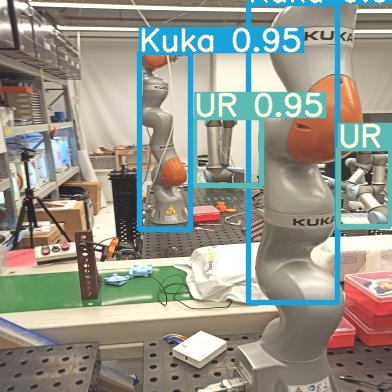

In [80]:
%cp '/content/train/images/IMG_20200728_024945_jpg.rf.f38f901e7aa8ba955c93b5d134231c2a.jpg' '/content/test.jpg'
!python detect.py --weights runs/exp8_yolov5l/weights/best_yolov5l.pt --img 416 --conf 0.4 --source '/content/test.jpg'
# https://github.com/ultralytics/yolov5/issues/303 TTA explained, better detect quality
# $ python detect.py --weights yolov5s.pt --img 896 --conf 0.3 --source ./inference/images/ --augment
# inference/images/
# %ls /content/yolov5/inference/output/
Image(filename='inference/output/test.jpg', width=600)

In [81]:
# %cp /content/gdrive/My\ Drive/photos/data/VID_2020.mp4 /content/VID_2020.mp4
!python detect.py --weights runs/exp8_yolov5l/weights/best_yolov5l.pt --img 416 --conf 0.4 --source /content/VID_2020.mp4
clear_output()
%cp inference/output/VID_2020.mp4 /content/gdrive/My\ Drive/photos/data/VID_2020_proc.mp4

Training losses and performance metrics are saved to Tensorboard and also to a `runs/exp0/results.txt` logfile. `results.txt` is plotted as `results.png` after training completes. Partially completed `results.txt` files can be plotted with `from utils.utils import plot_results; plot_results()`. Here we show YOLOv5s trained on coco128 to 300 epochs, starting from scratch (blue), and from pretrained `yolov5s.pt` (orange).

In [ ]:
%cd /content/yolov5/
from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets
# from utils import plot_results; plot_results()  # plot results.txt files as results.pnggoogle_utils

In [ ]:
# %cp /yolov5/weights/last_yolov5s_results.pt /content/gdrive/My\ Drive
%cp runs/exp3_yolov5s_v3/weights/best_yolov5s_v3.pt /content/gdrive/My\ Drive